In [1]:
import datetime

import altair as alt
import folium
import geojson
import pytz
import seaborn as sns
import shapely.wkt
from folium.plugins import TimestampedGeoJson
from google.cloud import bigquery

In [2]:
bq_client = bigquery.Client()

## Exploratory analysis

In [3]:
# Which days saw the most severe outages?


def get_outages_by_day(
    start_date: datetime.datetime,
    end_date: datetime.datetime,
    counties: tuple[int] = (3, 540),
):
    return (
        bq_client.query(
            """
        select
          timestamp_trunc(directory_timestamp, day) as day,
          st_union_agg(safe.st_geogfromtext(area_shape)) as area_geometry,
          max(`desc`.cust_a.val) as max_customers_impacted,
        from cvilledata.dominion.parquet_test
        -- from cvilledata.dominion.outages_dominion
        where directory_timestamp between @start_date and @end_date
          and title = 'Outage Information'
          and length(file_title) = 14
          and st_intersects(
            safe.st_geogfromtext(area_shape),
            (
              select
                st_union_agg(st_geogfromgeojson(geometry))
              from cvilledata.census.census_tracts_2020_51
              where countyfp in unnest(@counties)
            )
          )
        group by 1
        """,
            job_config=bigquery.QueryJobConfig(
                query_parameters=[
                    bigquery.ScalarQueryParameter(
                        "start_date", "TIMESTAMP", start_date
                    ),
                    bigquery.ScalarQueryParameter("end_date", "TIMESTAMP", end_date),
                    bigquery.ArrayQueryParameter("counties", "INT64", counties),
                ]
            ),
        )
        .result()
        .to_geodataframe()
    )


outages_by_day = get_outages_by_day(datetime.datetime(2022, 1, 1), datetime.datetime(2022, 12, 31))

alt.Chart(outages_by_day).mark_circle().encode(
    x="day:T", y="max_customers_impacted:Q", tooltip=["day", "max_customers_impacted"]
).interactive()

alt.Chart(...)

In [4]:
# Replay a few significant outage events


def get_outages_for_replay(
    start_date: datetime.datetime,
    end_date: datetime.datetime,
    granularity: int = 900,
    counties: tuple[int] = (3, 540),
):
    return (
        bq_client.query(
            """
        select
          *,
          timestamp_seconds(@granularity * div(unix_seconds(directory_timestamp), @granularity)) as timestamp_rounded,
        from cvilledata.dominion.outages_dominion
        where directory_timestamp between @start_date and @end_date
          and title = 'Outage Information'
          and length(file_title) = 14
          and st_intersects(
            safe.st_geogfromtext(area_shape),
            (
              select
                st_union_agg(st_geogfromgeojson(geometry))
              from cvilledata.census.census_tracts_2020_51
              where countyfp in unnest(@counties)
            )
          )
        order by timestamp_rounded
        """,
            job_config=bigquery.QueryJobConfig(
                query_parameters=[
                    bigquery.ScalarQueryParameter(
                        "start_date", "TIMESTAMP", start_date
                    ),
                    bigquery.ScalarQueryParameter("end_date", "TIMESTAMP", end_date),
                    bigquery.ScalarQueryParameter("granularity", "INT64", granularity),
                    bigquery.ArrayQueryParameter("counties", "INT64", counties),
                ]
            ),
        )
        .result()
        .to_dataframe()
    )


def to_replay_feature(row):
    return geojson.Feature(
        id=row.name,
        geometry=shapely.wkt.loads(row.area_shape),
        properties={
            "times": [
                row.timestamp_rounded.replace(
                    tzinfo=pytz.timezone("US/Eastern")
                ).timestamp()
                * 1000
            ],
        },
    )

In [5]:
# Replay early January outages

outages_for_replay = get_outages_for_replay(
    datetime.datetime(2022, 1, 3), datetime.datetime(2022, 1, 9)
)
features = outages_for_replay.apply(to_replay_feature, axis=1)
feature_collection = geojson.FeatureCollection(list(features))

map_ = folium.Map(
    [
        38.0293,
        -78.4767,
    ],
    zoom_start=13,
)
TimestampedGeoJson(
    dict(feature_collection),
    auto_play=True,
    period="PT15M",
    duration="PT1S",
    max_speed=25,
    loop=False,
).add_to(map_)
map_

In [6]:
# Replay early May outages

outages_for_replay = get_outages_for_replay(
    datetime.datetime(2022, 6, 1), datetime.datetime(2022, 6, 5)
)
features = outages_for_replay.apply(to_replay_feature, axis=1)
feature_collection = geojson.FeatureCollection(list(features))

map_ = folium.Map(
    [
        38.0293,
        -78.4767,
    ],
    zoom_start=13,
)
TimestampedGeoJson(
    dict(feature_collection),
    auto_play=True,
    period="PT15M",
    duration="PT1S",
    max_speed=25,
    loop=False,
).add_to(map_)
map_

In [7]:
# Replay late December outages

outages_for_replay = get_outages_for_replay(
    datetime.datetime(2022, 12, 23), datetime.datetime(2022, 12, 26)
)
features = outages_for_replay.apply(to_replay_feature, axis=1)
feature_collection = geojson.FeatureCollection(list(features))

map_ = folium.Map(
    [
        38.0293,
        -78.4767,
    ],
    zoom_start=13,
)
TimestampedGeoJson(
    dict(feature_collection),
    auto_play=True,
    period="PT15M",
    duration="PT1S",
    max_speed=25,
    loop=False,
).add_to(map_)
map_

In [8]:
# Count outages by duration


def get_outages_by_duration(
    start_date: datetime.datetime,
    end_date: datetime.datetime,
    counties: tuple[int] = (3, 540),
):
    return (
        bq_client.query(
            """
        select
          `desc`.inc_id,
          st_union_agg(st_geogfromtext(area_shape)) as area_geometry,
          avg(`desc`.cust_a.val) as customers_impacted,
          min(directory_timestamp) as start_time,
          max(directory_timestamp) as end_time,
          timestamp_diff(max(directory_timestamp), min(directory_timestamp), minute) / 60 as duration_hours,
        from cvilledata.dominion.outages_dominion
        where directory_timestamp between @start_date and @end_date
          and title = 'Outage Information'
          and length(file_title) = 14
          and st_intersects(
            safe.st_geogfromtext(area_shape),
            (
              select
                st_union_agg(st_geogfromgeojson(geometry))
              from cvilledata.census.census_tracts_2020_51
              where countyfp in unnest(@counties)
            )
          )
        group by inc_id
        """,
            job_config=bigquery.QueryJobConfig(
                query_parameters=[
                    bigquery.ScalarQueryParameter(
                        "start_date", "TIMESTAMP", start_date
                    ),
                    bigquery.ScalarQueryParameter("end_date", "TIMESTAMP", end_date),
                    bigquery.ArrayQueryParameter("counties", "INT64", counties),
                ]
            ),
        )
        .result()
        .to_geodataframe()
    )


outages_by_duration = get_outages_by_duration(
    datetime.datetime(2022, 1, 1), datetime.datetime(2022, 12, 31)
)

In [9]:
alt.Chart(outages_by_duration).mark_circle().encode(
    x="start_time:T",
    y="customers_impacted:Q",
    size="duration_hours:Q",
    tooltip=["start_time", "customers_impacted"],
).interactive().properties(title="Outages over time, scaled by duration, 2022")

alt.Chart(...)

In [10]:
alt.Chart(outages_by_duration).mark_bar().encode(
    x=alt.X("duration_hours:Q").bin(maxbins=25),
    y="count()",
    tooltip=[alt.Tooltip("duration_hours:Q", bin=True), "count()"],
).properties(title="Distribution of outage durations, 2022")

alt.Chart(...)

## Summary 2019-2023

In [11]:
def get_outages_by_cause(
    start_date: datetime.datetime,
    end_date: datetime.datetime,
    counties: tuple[int] = (3, 540),
):
    return (
        bq_client.query(
            """
    with ranked as (
      select
        `desc`.inc_id,
        `desc`.cause,
        row_number() over(partition by `desc`.inc_id order by directory_timestamp desc) as ordinal,
      from cvilledata.dominion.outages_dominion
      where directory_timestamp between @start_date and @end_date
        and title = 'Outage Information'
        and length(file_title) = 14
        and st_intersects(
          safe.st_geogfromtext(area_shape),
          (
            select
              st_union_agg(st_geogfromgeojson(geometry))
            from cvilledata.census.census_tracts_2020_51
            where countyfp in unnest(@counties)
          )
        )
    )
    select
      cause,
      count(1) as count,
    from ranked
    where ordinal = 1
    group by cause
        """,
            job_config=bigquery.QueryJobConfig(
                query_parameters=[
                    bigquery.ScalarQueryParameter(
                        "start_date", "TIMESTAMP", start_date
                    ),
                    bigquery.ScalarQueryParameter("end_date", "TIMESTAMP", end_date),
                    bigquery.ArrayQueryParameter("counties", "INT64", counties),
                ]
            ),
        )
        .result()
        .to_dataframe()
    )


outages_by_cause = get_outages_by_cause(
    datetime.datetime(2019, 1, 1), datetime.datetime(2023, 12, 31)
)

alt.Chart(outages_by_cause).mark_bar().encode(
    y=alt.X("cause:N").sort("-x"), x="count:Q", tooltip=["cause", "count"]
).properties(
    title="Outage count by cause, 2019-2023",
)

alt.Chart(...)

In [12]:
def get_outages_by_month(
    start_date: datetime.datetime,
    end_date: datetime.datetime,
    counties: tuple[int] = (3, 540),
):
    return (
        bq_client.query(
            """
    with census as (
      select
        st_union_agg(st_geogfromgeojson(geometry)) as geometry
      from cvilledata.census.census_tracts_2020_51
      where countyfp in unnest(@counties)
    )
    select
      cast(extract(month from directory_timestamp) as float64) as month,
      cast(extract(year from directory_timestamp) as float64) as year,
      sum(
        `desc`.cust_a.val * (
          st_area(st_intersection(safe.st_geogfromtext(outages_dominion.area_shape), census.geometry)) /
            st_area(safe.st_geogfromtext(outages_dominion.area_shape))
        )
      ) / 4 as customer_hours_weighted,
    from cvilledata.dominion.outages_dominion
    join census on st_intersects(safe.st_geogfromtext(outages_dominion.area_shape), census.geometry)
    where directory_timestamp between @start_date and @end_date
      and title = 'Outage Information'
      and length(file_title) = 14
    group by 2, 1
        """,
            job_config=bigquery.QueryJobConfig(
                query_parameters=[
                    bigquery.ScalarQueryParameter(
                        "start_date", "TIMESTAMP", start_date
                    ),
                    bigquery.ScalarQueryParameter("end_date", "TIMESTAMP", end_date),
                    bigquery.ArrayQueryParameter("counties", "INT64", counties),
                ]
            ),
        )
        .result()
        .to_dataframe()
    )


outages_by_month = get_outages_by_month(
    datetime.datetime(2019, 1, 1), datetime.datetime(2023, 12, 31)
)

In [13]:
alt.Chart(outages_by_month.groupby(["month"]).mean().reset_index()).mark_line().encode(
    x="month:Q",
    y="customer_hours_weighted:Q",
    tooltip=["month", "customer_hours_weighted"],
).properties(
    title="Outage severity by month",
)

alt.Chart(...)

In [14]:
alt.Chart(outages_by_month).mark_line().encode(
    x="month:Q",
    y="customer_hours_weighted:Q",
    color="year:N",
    tooltip=["month", "year", "customer_hours_weighted"],
).properties(
    title="Outage severity by month and year",
)

alt.Chart(...)

## Scratch

In [ ]:
bq_client.query(
    """
select
  id,
  title,
  file_title,
  directory_timestamp,
  `desc`.cust_a.val as val,
  `desc`.inc_id as inc_id,
  `desc`.n_out as n_out,
  timestamp_seconds(900 * div(unix_seconds(directory_timestamp), 900)) as timestamp_rounded,
from cvilledata.dominion.outages_dominion
where directory_timestamp between '2022-01-01' and '2022-01-31'
  and length(file_title) = 14
  and st_intersects(
    safe.st_geogfromtext(area_shape),
    (
      select
        st_union_agg(st_geogfromgeojson(geometry))
      from cvilledata.census.census_tracts_2020_51
      where countyfp = 540
    )
  )
order by directory_timestamp
    """
).result().to_dataframe()

In [ ]:
outages = (
    bq_client.query(
        """
select
  timestamp_trunc(directory_timestamp, hour) as hour,
  st_union_agg(safe.st_geogfromtext(area_shape)) as area_geometry,
  max(`desc`.cust_a.val) as max_customers_impacted,
from cvilledata.dominion.outages_dominion
where directory_timestamp between '2022-01-01' and '2022-12-31'
  and length(file_title) = 14
  and st_intersects(
    safe.st_geogfromtext(area_shape),
    (
      select
        st_union_agg(st_geogfromgeojson(geometry))
      from cvilledata.census.census_tracts_2020_51
      where countyfp in (3, 540)
    )
  )
group by 1
    """
    )
    .result()
    .to_geodataframe()
)

In [ ]:
bq_client.query(
    """
select
  id,
  file_title,
  count(1) as count,
from cvilledata.dominion.outages_dominion
where directory_timestamp between '2022-01-01' and '2022-01-05'
  and length(file_title) = 14
  and st_intersects(
    safe.st_geogfromtext(area_shape),
    (
      select
        st_union_agg(st_geogfromgeojson(geometry))
      from cvilledata.census.census_tracts_2020_51
      where countyfp = 540
    )
  )
group by id, file_title, directory_timestamp
having count(1) > 1
    """
).result().to_dataframe()

In [9]:
def outages_for_replay(
    start_date: datetime.datetime,
    end_date: datetime.datetime,
    granularity: int = 900,
    counties: tuple[int] = (3, 540),
):
    return (
        bq_client.query(
            """
        select
          *,
          timestamp_seconds(@granularity * div(unix_seconds(directory_timestamp), @granularity)) as timestamp_rounded,
        from cvilledata.dominion.outages_dominion
        where directory_timestamp between @start_date and @end_date
          and length(file_title) = 14
          and st_intersects(
            safe.st_geogfromtext(area_shape),
            (
              select
                st_union_agg(st_geogfromgeojson(geometry))
              from cvilledata.census.census_tracts_2020_51
              where countyfp in unnest(@counties)
            )
          )
        order by timestamp_rounded
        """,
            job_config=bigquery.QueryJobConfig(
                query_parameters=[
                    bigquery.ScalarQueryParameter(
                        "start_date", "TIMESTAMP", start_date
                    ),
                    bigquery.ScalarQueryParameter("end_date", "TIMESTAMP", end_date),
                    bigquery.ScalarQueryParameter("granularity", "INT64", granularity),
                    bigquery.ArrayQueryParameter("counties", "INT64", counties),
                ]
            ),
        )
        .result()
        .to_dataframe()
    )


def to_replay_feature(row):
    return geojson.Feature(
        id=row.name,
        geometry=shapely.wkt.loads(row.area_shape),
        properties={
            "times": [
                row.timestamp_rounded.replace(
                    tzinfo=pytz.timezone("US/Eastern")
                ).timestamp()
                * 1000
            ],
        },
    )


outages = outages_for_replay(
    datetime.datetime(2022, 1, 3), datetime.datetime(2022, 1, 9)
)
features = outages.apply(to_replay_feature, axis=1)
feature_collection = geojson.FeatureCollection(list(features))

map_ = folium.Map(
    [
        38.0293,
        -78.4767,
    ],
    zoom_start=13,
)
TimestampedGeoJson(
    dict(feature_collection),
    auto_play=True,
    period="PT15M",
    duration="PT1S",
    max_speed=25,
    loop=False,
).add_to(map_)
map_

In [20]:
outages = (
    bq_client.query(
        """
with census as (
  select
    st_union_agg(st_geogfromgeojson(geometry)) as geometry
  from cvilledata.census.census_tracts_2020_51
  where countyfp in (3, 540)
)
select
  -- timestamp_trunc(directory_timestamp, month) as month,
  cast(extract(month from directory_timestamp) as float64) as month,
  cast(extract(year from directory_timestamp) as float64) as year,
  sum(
    `desc`.cust_a.val * (
      st_area(st_intersection(safe.st_geogfromtext(outages_dominion.area_shape), census.geometry)) /
        st_area(safe.st_geogfromtext(outages_dominion.area_shape))
    )
  ) as customers_weighted,
from cvilledata.dominion.outages_dominion
join census on st_intersects(safe.st_geogfromtext(outages_dominion.area_shape), census.geometry)
where directory_timestamp between '2019-01-01' and '2022-12-31'
  and length(file_title) = 14
group by 2, 1
order by 2, 1
    """
    )
    .result()
    .to_dataframe()
)

# outages = bq_client.query(
#     """
# select
#   -- timestamp_trunc(directory_timestamp, month) as month,
#   cast(extract(month from directory_timestamp) as float64) as month,
#   cast(extract(year from directory_timestamp) as float64) as year,
#   cast(sum(
#     `desc`.cust_a.val) as float64) as customers_weighted,
# from cvilledata.dominion.outages_dominion
# where directory_timestamp between '2019-01-01' and '2022-12-31'
#   and length(file_title) = 14
# group by 2, 1
# order by 2, 1
#     """
# ).result().to_dataframe()

month                 float64
year                  float64
customers_weighted    float64
dtype: object

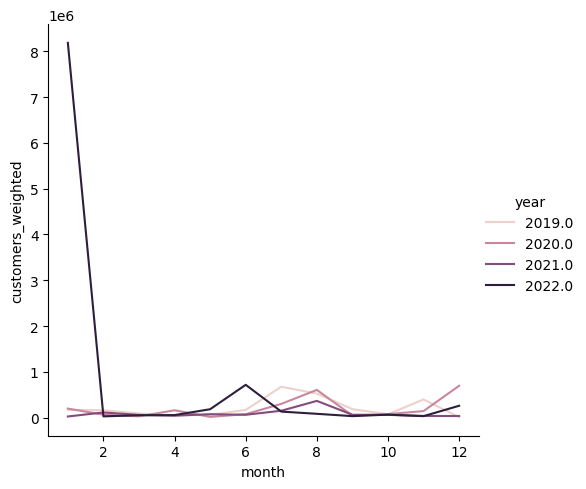

In [21]:
sns.relplot(
    data=outages,
    x="month",
    y="customers_weighted",
    hue="year",
    kind="line",
)
# # outages.plot()
outages.dtypes

In [ ]:
import pandas

pandas.set_option("display.max_rows", 100)
outages

In [ ]:
328414 / 24 / 4

In [ ]:
import pandas as pd
import matplotlib as plt
import geopandas as gpd
import shapely
from shapely import wkt

data = {
    "name": ["polygon A", "polygon B", "polygon C", "D"],
    "id": [1, 2, 3, 4],
    "geom": [
        "MULTIPOLYGON (((36.00000 11.00000, 36.00000 12.00000, 37.00000 12.00000, 37.00000 11.00000, 36.00000 11.00000)))",
        "MULTIPOLYGON (((36.50000 11.50000, 37.50000 11.50000, 37.50000 11.00000, 36.50000 11.00000, 36.50000 11.50000)))",
        "MULTIPOLYGON (((36.61799 10.80580, 36.61570 11.19321, 36.86327 11.29637, 37.34925 10.91813, 37.00540 10.71182, 36.61799 10.80580)))",
        "MULTIPOLYGON (((26.00000 01.00000, 26.00000 02.00000, 27.00000 02.00000, 27.00000 01.00000, 26.00000 01.00000)))",
    ],
}

df = pd.DataFrame(data, columns=["name", "id", "geom"])
df["geom"] = df["geom"].apply(wkt.loads)
gdf = gpd.GeoDataFrame(df, geometry="geom")

gdf.plot(alpha=0.5, column="id")

In [ ]:
df

In [ ]:
bounds = gdf.geometry.convex_hull.exterior.buffer(0.00001).unary_union
new_polys = list(shapely.ops.polygonize(bounds))

In [ ]:
gdf.geometry.convex_hull.exterior.unary_union

In [ ]:
str(new_polys[1])

In [ ]:
npdf = gpd.GeoDataFrame(geometry=new_polys[0:1])
# npdf["idx"] = range(len(new_polys) - 1)
npdf["idx"] = [0]
npdf.plot(alpha=0.5, linewidth=2, column="idx")

In [ ]:
ogdf = gpd.GeoDataFrame(geometry=new_polys)
[ogdf.geometry.intersects(poly) for poly in gdf.geometry.values]

In [ ]:
SMALL_VALUE = 1e-9


def overlap_count(in_gdf):
    """Count overlaps over a geodataframe.

    Adapted from https://gis.stackexchange.com/a/424161.
    """
    bounds = in_gdf.geometry.convex_hull.exterior.buffer(SMALL_VALUE).unary_union
    polygons = list(shapely.ops.polygonize(bounds))
    out_gdf = gpd.GeoDataFrame(geometry=polygons)
    out_gdf["overlaps"] = sum(
        [out_gdf.geometry.intersects(poly) for poly in in_gdf.geometry.values]
    )
    return out_gdf


def overlap_count_sjoin(in_gdf):
    bounds = in_gdf.geometry.convex_hull.exterior.buffer(SMALL_VALUE).unary_union
    polygons = list(shapely.ops.polygonize(bounds))[1:]
    out_gdf = gpd.GeoDataFrame(geometry=polygons, crs=in_gdf.crs)
    out_gdf["polygon_id"] = range(len(out_gdf))
    joined = gpd.sjoin(out_gdf, in_gdf)
    counts = (
        joined.groupby(["polygon_id"])["index_right"]
        .count()
        .rename("count")
        .reset_index()
    )
    return pd.merge(out_gdf, counts)

In [ ]:
overlap_count(gdf).plot("overlaps", legend=True)

In [ ]:
overlap_count_sjoin(gdf).plot("count", legend=True)

In [ ]:
?gpd.sjoin

In [ ]:
overlap_count(gdf).plot("overlaps", legend=True)

In [ ]:
overlap_count(gdf)

In [ ]:
outages = (
    bq_client.query(
        """
select
  timestamp_trunc(directory_timestamp, hour) as hour,
  st_union_agg(safe.st_geogfromtext(area_shape)) as area_geometry,
  max(`desc`.cust_a.val) as max_customers_impacted,
from cvilledata.dominion.outages_dominion
where directory_timestamp between '2022-01-01' and '2022-12-31'
  and length(file_title) = 14
  and st_intersects(
    safe.st_geogfromtext(area_shape),
    (
      select
        st_union_agg(st_geogfromgeojson(geometry))
      from cvilledata.census.census_tracts_2020_51
      where countyfp in (3, 540)
    )
  )
group by 1
    """
    )
    .result()
    .to_geodataframe()
)

In [ ]:
outages_flat = outages.explode().reset_index(drop=True)

In [ ]:
# outages.set_crs("WGS84")
overlap = overlap_count_sjoin(outages_flat)

In [ ]:
overlap.plot("count", legend=True)

In [ ]:
map_ = folium.Map(
    [
        38.0293,
        -78.4767,
    ],
    zoom_start=13,
)

nhood_colormap = branca.colormap.linear.YlOrRd_09
nhood_color_values = overlap["count"]
nhood_colormap = nhood_colormap.scale(*list(np.percentile(nhood_color_values, [5, 95])))


def style(feature):
    color_value = feature["properties"]["count"]
    if color_value is None or np.isnan(color_value):
        fill_color = "white"
    else:
        fill_color = nhood_colormap.rgb_hex_str(color_value)
    return {
        "color": "black",
        "weight": 0.05,
        "fillOpacity": 0.8,
        "fillColor": fill_color,
    }


folium.GeoJson(
    overlap.set_crs("WGS84"),
    tooltip=folium.GeoJsonTooltip(fields=["count"], labels=True),
    style_function=style,
).add_to(map_)

map_